Images found: ['IMG_9045.jpg', 'IMG_9046.jpg', 'IMG_9047.jpg', 'IMG_9049.jpg', 'IMG_9050.jpg']


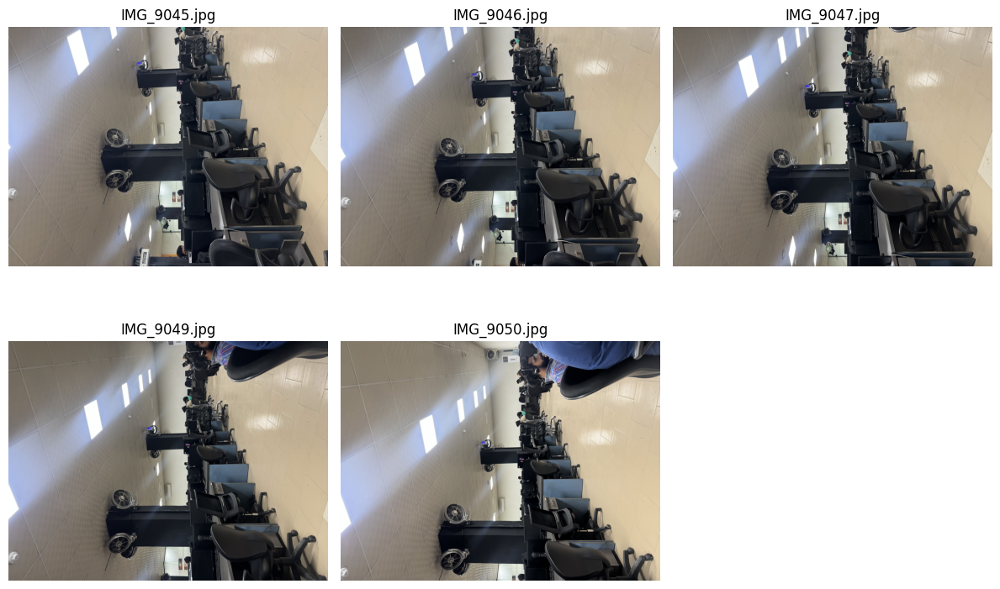

In [1]:
import os
import zipfile
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

zip_path = "/content/image.zip"
extract_path = "/content/images"

# Extract zip (only once)
if not os.path.exists(extract_path):
    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        zip_ref.extractall(extract_path)

# Since images are inside 'image/' folder inside the zip
dataset_path = os.path.join(extract_path, "image")

# Get image files
image_files = [f for f in os.listdir(dataset_path) if f.lower().endswith((".jpg", ".jpeg", ".png"))]
image_files = sorted(image_files)
print("Images found:", image_files)

# Plot in a 2x3 grid (since you have 6 images)
plt.figure(figsize=(12, 8))
cols = 3
rows = (len(image_files) + cols - 1) // cols
for i, img_file in enumerate(image_files):
    img_path = os.path.join(dataset_path, img_file)
    img = mpimg.imread(img_path)

    plt.subplot(rows, cols, i+1)
    plt.imshow(img)
    plt.axis("off")
    plt.title(img_file)

plt.tight_layout()
plt.show()


Images found: ['IMG_9045.jpg', 'IMG_9046.jpg', 'IMG_9047.jpg', 'IMG_9049.jpg', 'IMG_9050.jpg']
Loaded 5 images. Shapes: [(1600, 1200), (1600, 1200), (1600, 1200), (1600, 1200), (1600, 1200)]


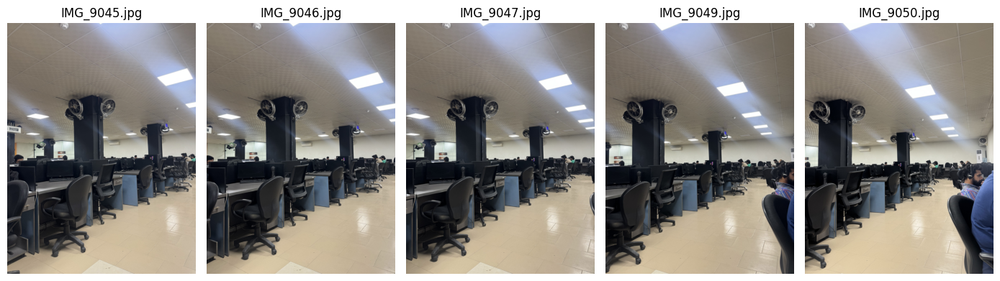

In [2]:
import cv2
image_files = [f for f in os.listdir(dataset_path) if f.lower().endswith((".jpg",".jpeg",".png"))]
image_files = sorted(image_files)
print("Images found:", image_files)

images_color = []
images_gray = []
orig_shapes = []

MAX_DIM = 1600  # to avoid extremely large images

for img_file in image_files:
    img_path = os.path.join(dataset_path, img_file)
    color = cv2.imread(img_path, cv2.IMREAD_COLOR)
    if color is None:
        raise RuntimeError(f"Failed to load {img_path}")
    h, w = color.shape[:2]
    orig_shapes.append((h,w))
    if MAX_DIM and max(h,w) > MAX_DIM:
        scale = MAX_DIM / float(max(h,w))
        color = cv2.resize(color, (int(w*scale), int(h*scale)), interpolation=cv2.INTER_AREA)
    gray = cv2.cvtColor(color, cv2.COLOR_BGR2GRAY)
    images_color.append(color)
    images_gray.append(gray)

print(f"Loaded {len(images_color)} images. Shapes:", [img.shape[:2] for img in images_color])

# Show thumbnails
plt.figure(figsize=(14, 4))
for i, img_file in enumerate(image_files):
    plt.subplot(1, len(image_files), i+1)
    plt.imshow(cv2.cvtColor(images_color[i], cv2.COLOR_BGR2RGB))
    plt.axis("off")
    plt.title(img_file)
plt.tight_layout()
plt.show()


Image 0 (IMG_9045.jpg): 30000 keypoints, descriptors shape (30000, 128)
Image 1 (IMG_9046.jpg): 30000 keypoints, descriptors shape (30000, 128)
Image 2 (IMG_9047.jpg): 30000 keypoints, descriptors shape (30000, 128)
Image 3 (IMG_9049.jpg): 30000 keypoints, descriptors shape (30000, 128)
Image 4 (IMG_9050.jpg): 30000 keypoints, descriptors shape (30000, 128)


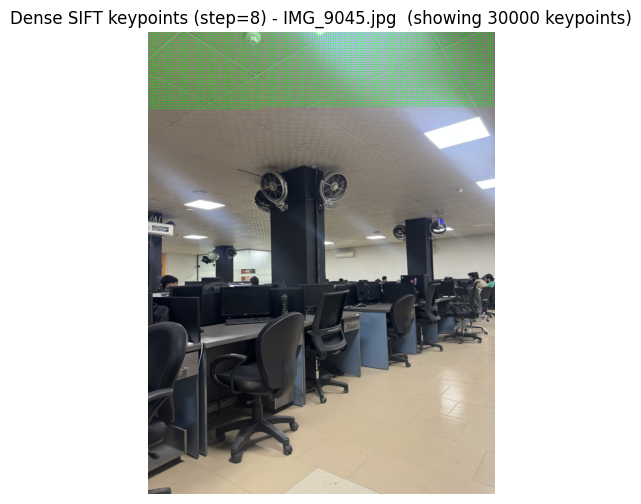

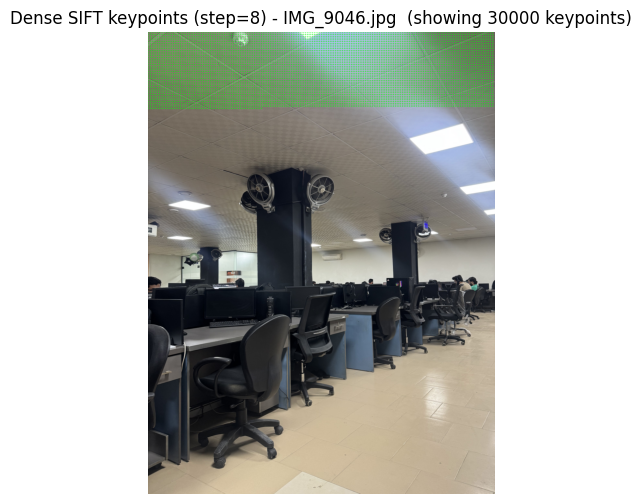

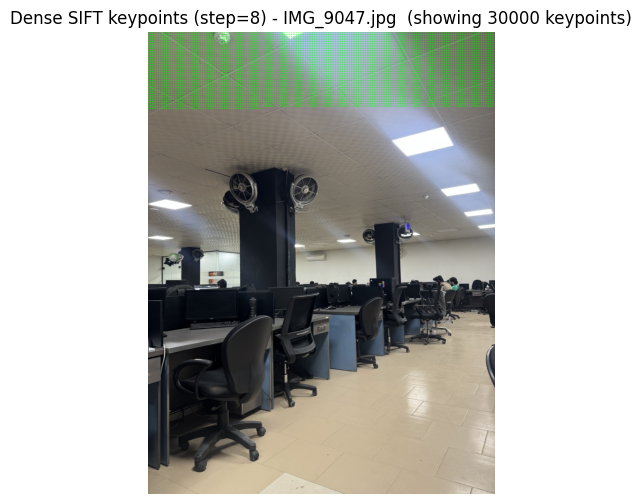

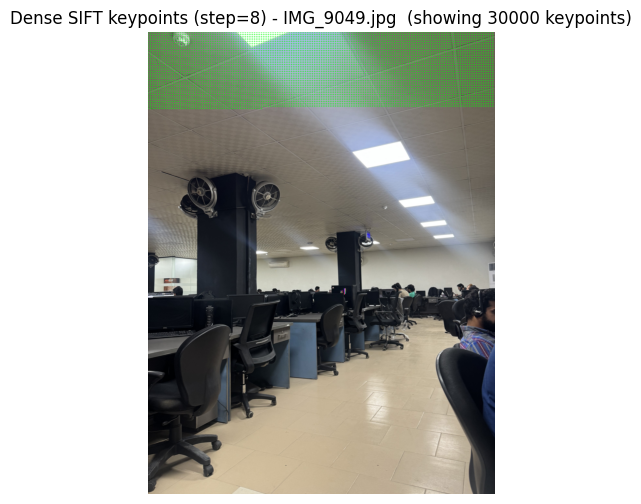

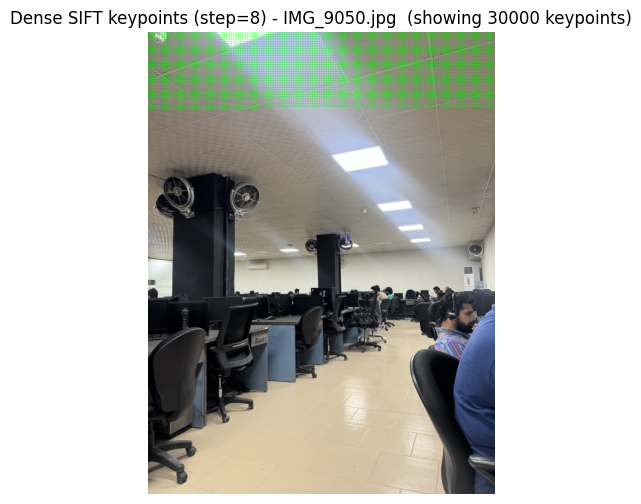

In [3]:
# Cell 3 - Dense SIFT + visualize keypoints as circles
sift = cv2.SIFT_create()

def dense_sift(img_gray, step_size=8):
    h, w = img_gray.shape[:2]
    keypoints = [cv2.KeyPoint(float(x), float(y), step_size)
                 for y in range(0, h, step_size)
                 for x in range(0, w, step_size)]
    keypoints, descriptors = sift.compute(img_gray, keypoints)
    return keypoints, descriptors

step = 8  # grid step for dense SIFT (tune as needed)
keypoints_list = []
descriptors_list = []

for i, gray in enumerate(images_gray):
    kps, des = dense_sift(gray, step_size=step)
    if des is None:
        des = np.zeros((0,128), dtype=np.float32)
    keypoints_list.append(kps)
    descriptors_list.append(des)
    print(f"Image {i} ({image_files[i]}): {len(kps)} keypoints, descriptors shape {des.shape}")

# Visualization: draw circles for keypoints (simple fixed-radius)
def draw_keypoints_circles(img, kps, radius=3, color=(0,255,0), thickness=1, max_kps=2000):
    vis = img.copy()
    n = min(len(kps), max_kps)
    for kp in kps[:n]:
        x, y = int(round(kp.pt[0])), int(round(kp.pt[1]))
        cv2.circle(vis, (x,y), radius, color, thickness, lineType=cv2.LINE_AA)
    return vis

# Show images with dense keypoints
for i, (img, kps) in enumerate(zip(images_color, keypoints_list)):
    vis = draw_keypoints_circles(img, kps, radius=2, color=(0,255,0), thickness=1, max_kps=5000)
    plt.figure(figsize=(8,6))
    plt.imshow(cv2.cvtColor(vis, cv2.COLOR_BGR2RGB))
    plt.axis("off")
    plt.title(f"Dense SIFT keypoints (step={step}) - {image_files[i]}  (showing {len(kps)} keypoints)")
    plt.show()


In [4]:
# Cell 4 - Helper functions to visualize matches and RANSAC inliers/outliers

def to_rgb(bgr):
    return cv2.cvtColor(bgr, cv2.COLOR_BGR2RGB)

def make_side_by_side(imgA, imgB):
    # Place two images side-by-side (pad to equal height)
    hA, wA = imgA.shape[:2]
    hB, wB = imgB.shape[:2]
    H = max(hA, hB)
    canvas = np.zeros((H, wA + wB, 3), dtype=np.uint8)
    canvas[:hA, :wA] = imgA
    canvas[:hB, wA:wA+wB] = imgB
    return canvas

def draw_matches_side_by_side(imgA, imgB, kpsA, kpsB, matches, matches_mask=None, max_draw=200):
    """
    imgA, imgB: BGR images
    kpsA: keypoints corresponding to imgA (query)
    kpsB: keypoints corresponding to imgB (train)
    matches: list of cv2.DMatch where .queryIdx -> kpsA, .trainIdx -> kpsB
    matches_mask: None or list-like with same length as matches where 1=inlier, 0=outlier
    """
    # Prepare canvas
    A = imgA.copy()
    B = imgB.copy()
    canvas = make_side_by_side(A, B)
    wA = A.shape[1]
    # Draw small circles at keypoints (in both images)
    for idx, m in enumerate(matches[:max_draw]):
        qa = m.queryIdx
        tb = m.trainIdx
        x1, y1 = int(round(kpsA[qa].pt[0])), int(round(kpsA[qa].pt[1]))
        x2, y2 = int(round(kpsB[tb].pt[0])), int(round(kpsB[tb].pt[1]))
        # color based on mask if provided
        if matches_mask is not None:
            color = (0,255,0) if matches_mask[idx] else (0,0,255)  # BGR: green for inlier, red for outlier
        else:
            color = (255,0,0)  # blue for raw
        # Draw circles
        cv2.circle(canvas, (x1, y1), 3, color, -1, lineType=cv2.LINE_AA)
        cv2.circle(canvas, (wA + x2, y2), 3, color, -1, lineType=cv2.LINE_AA)
        # Draw connecting line
        cv2.line(canvas, (x1, y1), (wA + x2, y2), color, 1, lineType=cv2.LINE_AA)
    return canvas


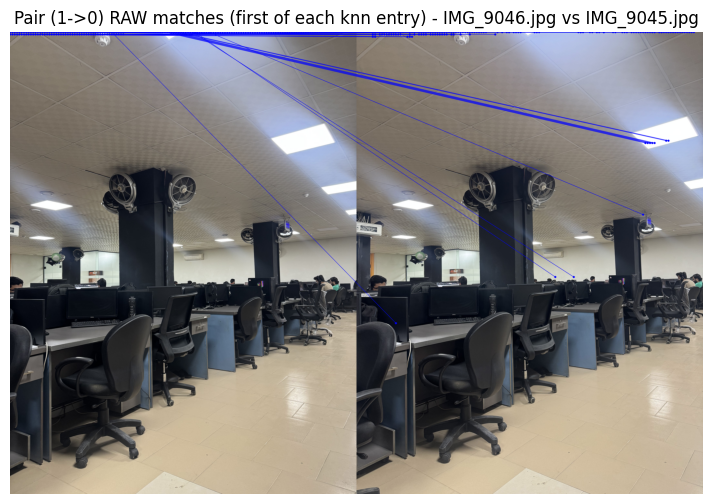

Pair (0,1): raw_simple=30000 good_after_ratio=12230


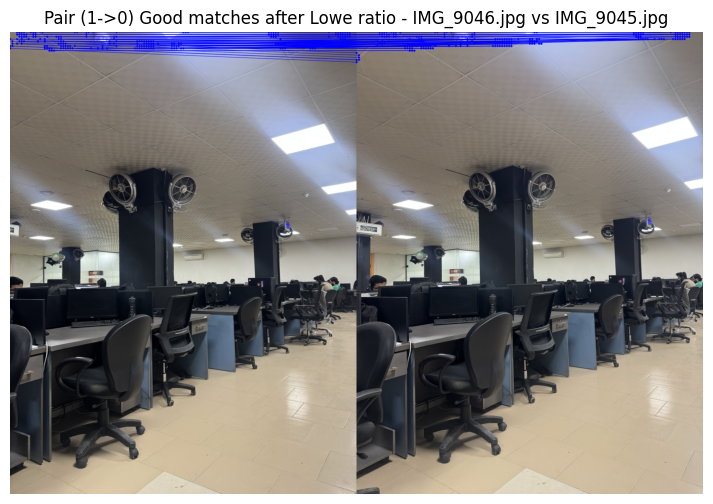

 Pair (0,1) inliers: 8702


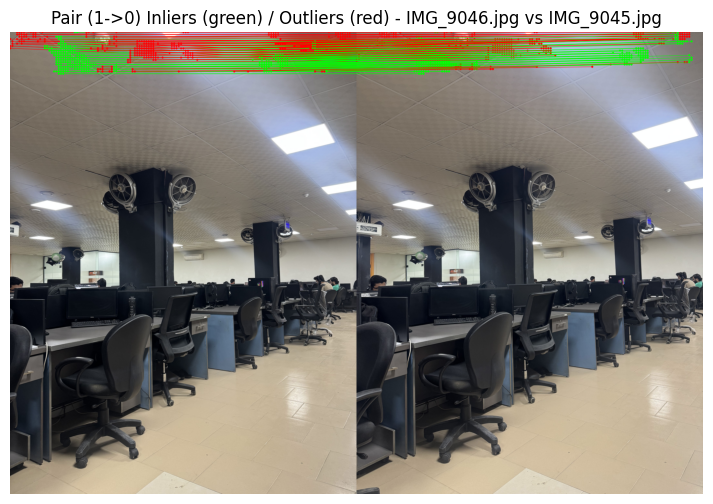

 Stored homography for pair (0,1) with 8702 inliers


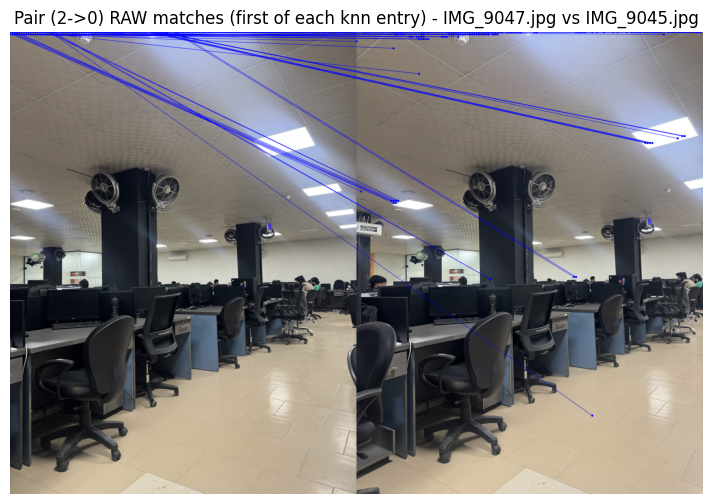

Pair (0,2): raw_simple=30000 good_after_ratio=10602


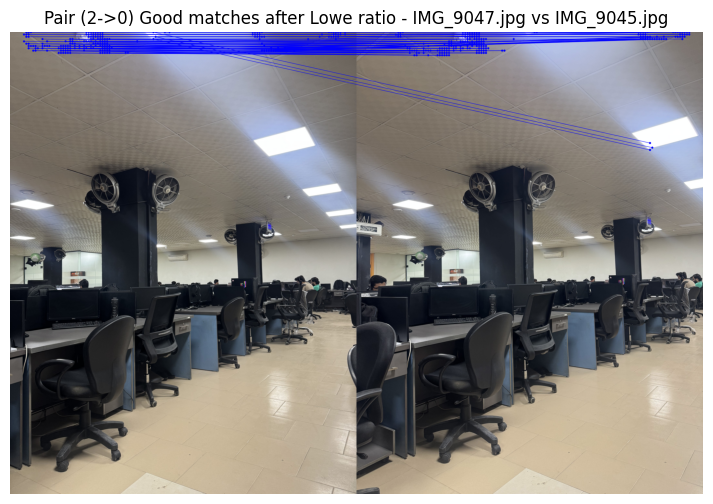

 Pair (0,2) inliers: 7557


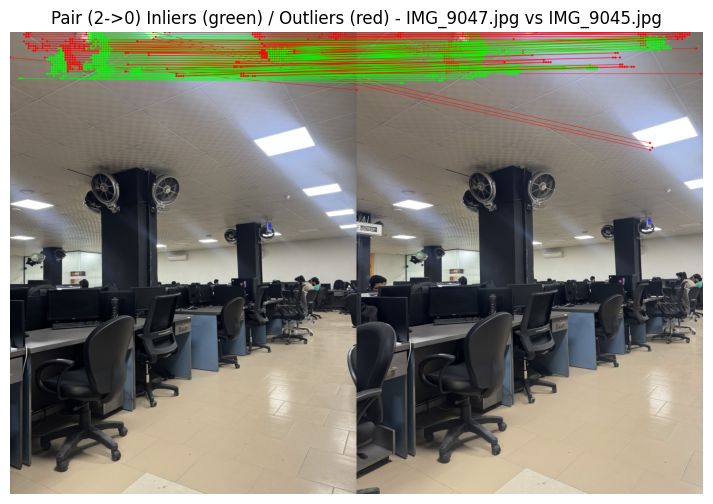

 Stored homography for pair (0,2) with 7557 inliers


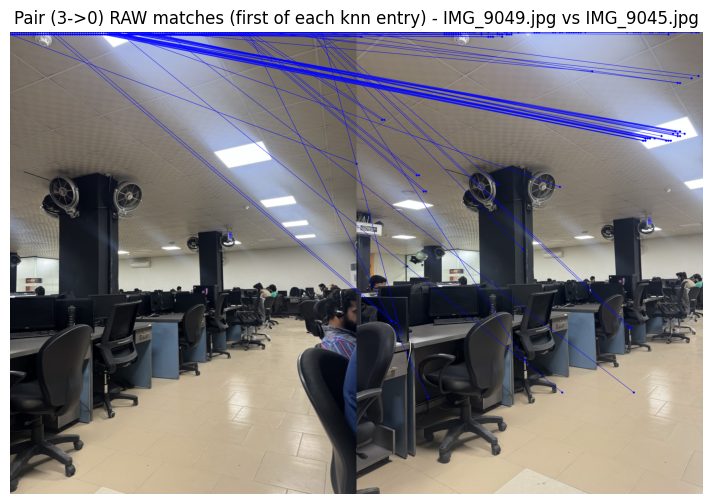

Pair (0,3): raw_simple=30000 good_after_ratio=6683


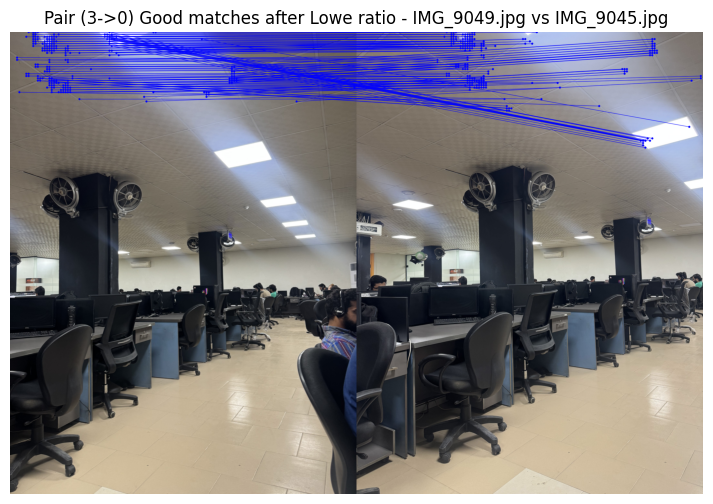

 Pair (0,3) inliers: 3669


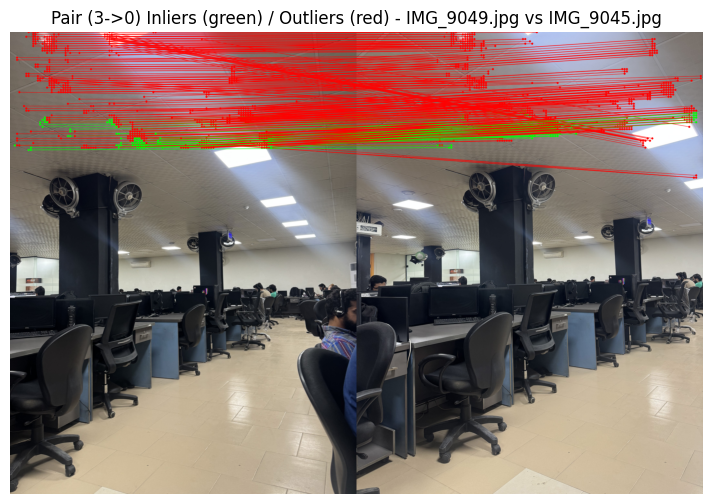

 Stored homography for pair (0,3) with 3669 inliers


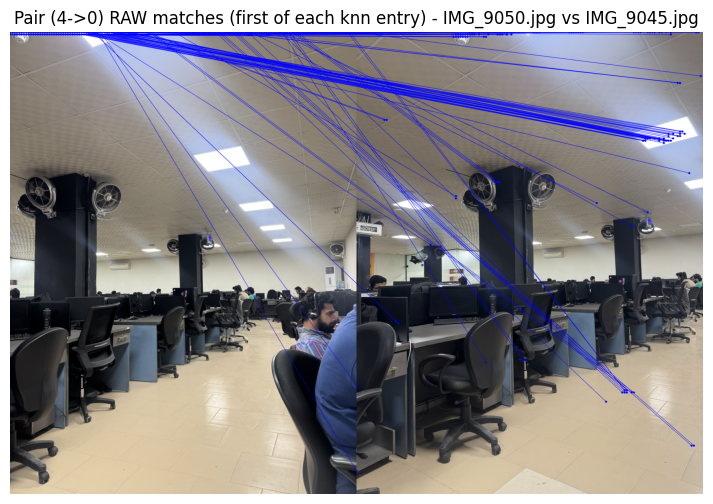

Pair (0,4): raw_simple=30000 good_after_ratio=5065


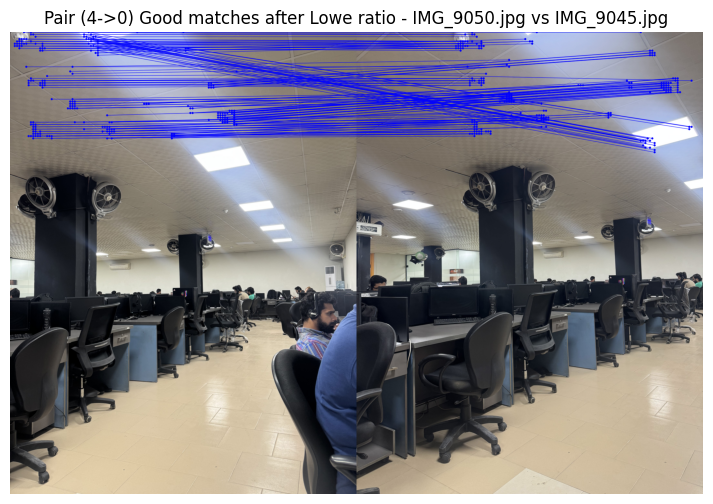

 Pair (0,4) inliers: 2311


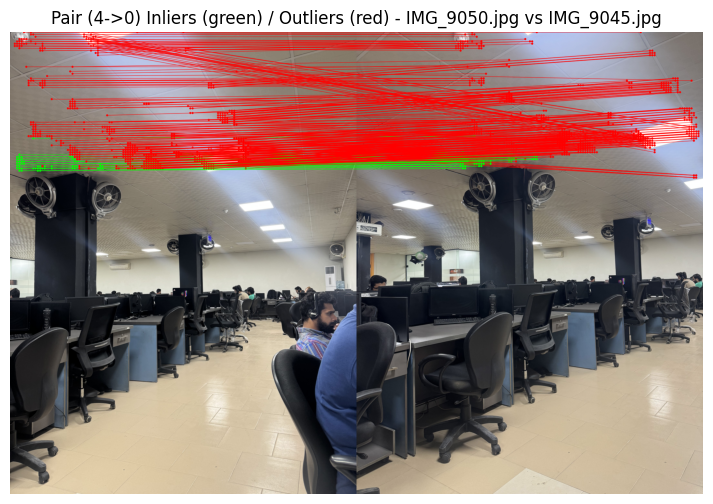

 Stored homography for pair (0,4) with 2311 inliers


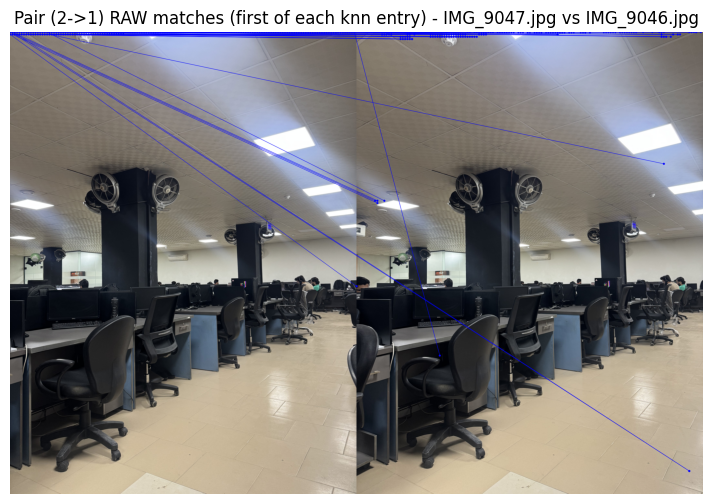

Pair (1,2): raw_simple=30000 good_after_ratio=11953


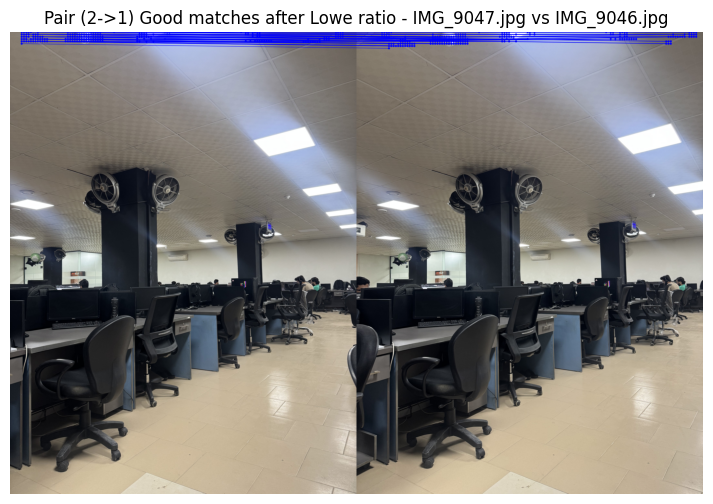

 Pair (1,2) inliers: 8255


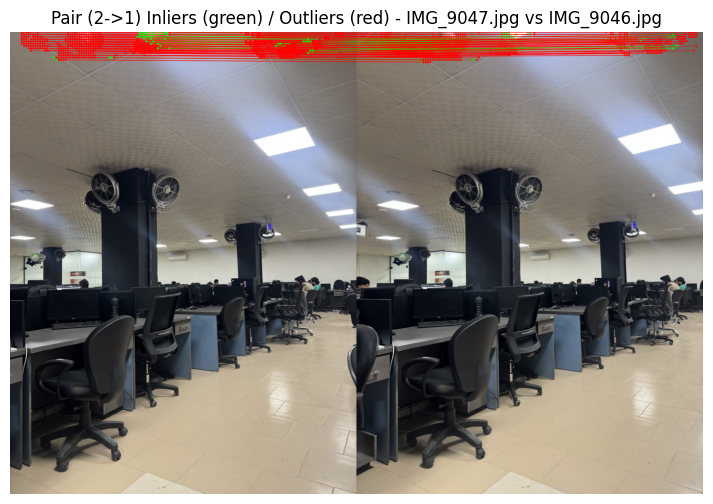

 Stored homography for pair (1,2) with 8255 inliers


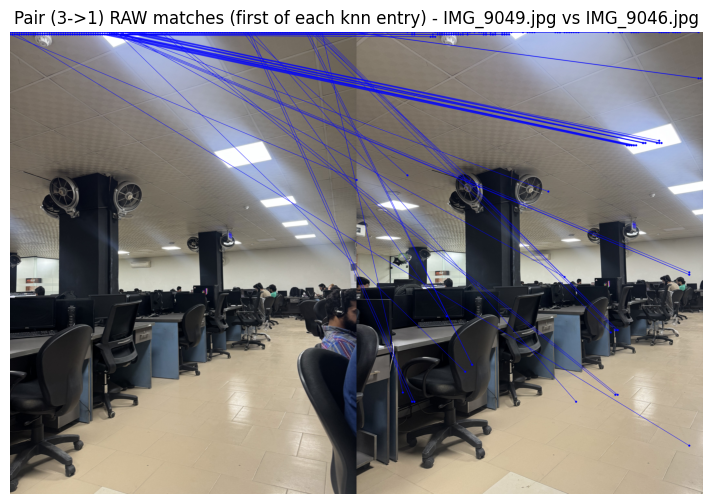

Pair (1,3): raw_simple=30000 good_after_ratio=7722


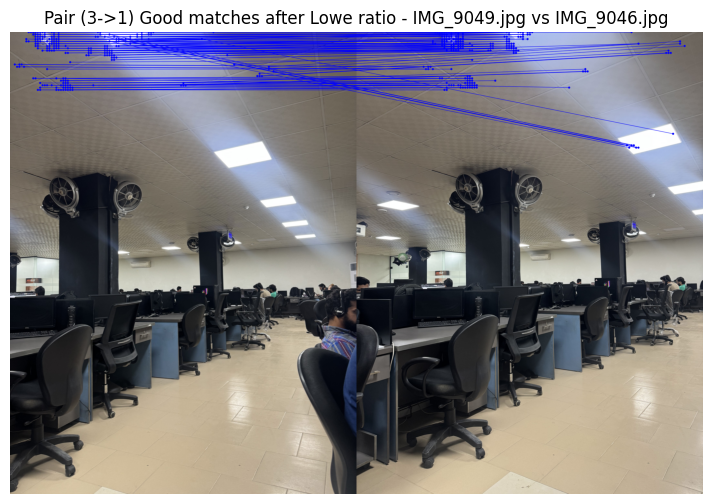

 Pair (1,3) inliers: 3799


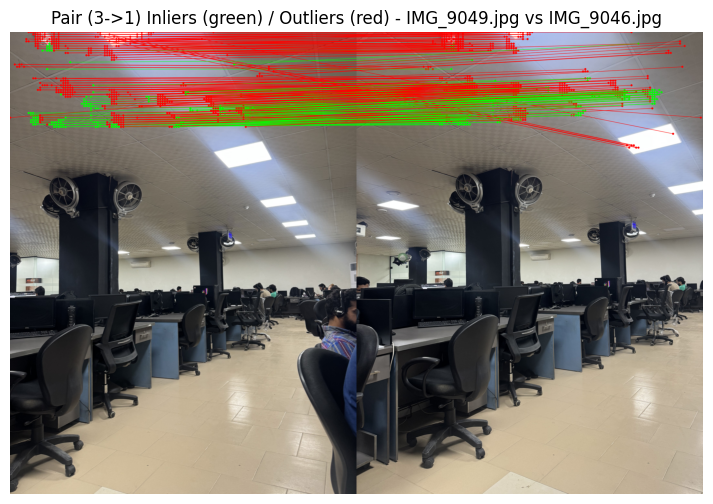

 Stored homography for pair (1,3) with 3799 inliers


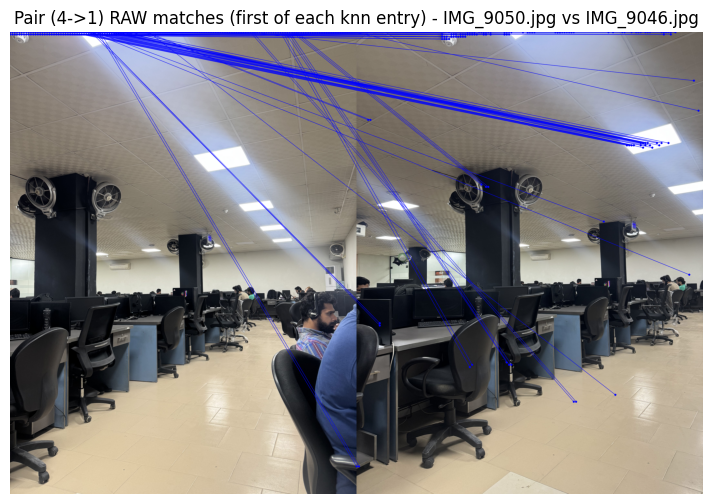

Pair (1,4): raw_simple=30000 good_after_ratio=6095


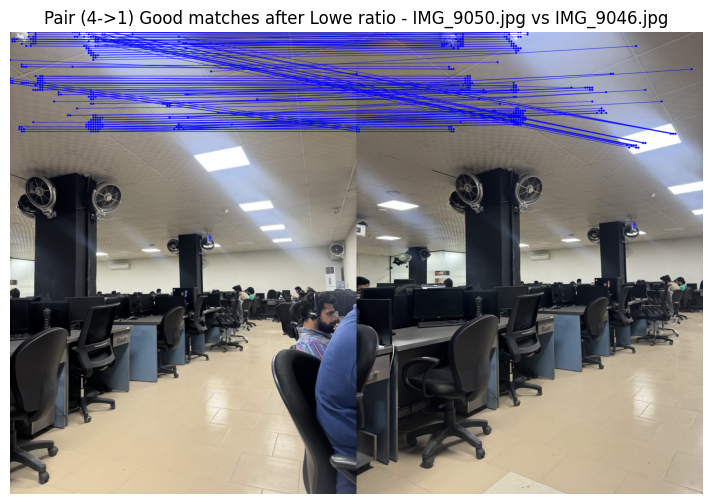

 Pair (1,4) inliers: 3017


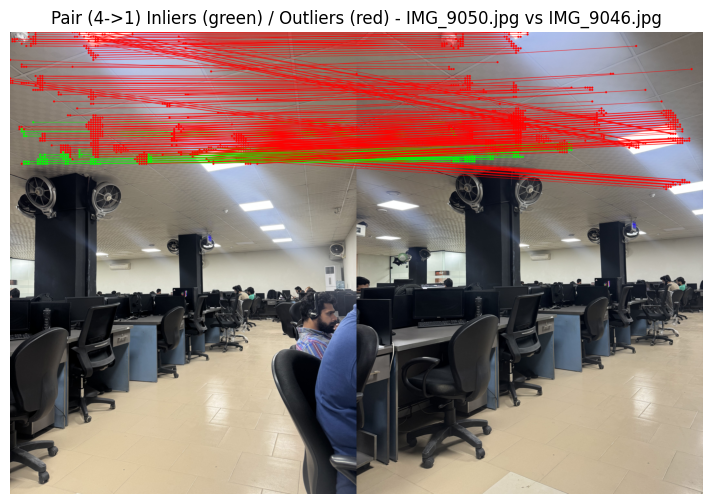

 Stored homography for pair (1,4) with 3017 inliers


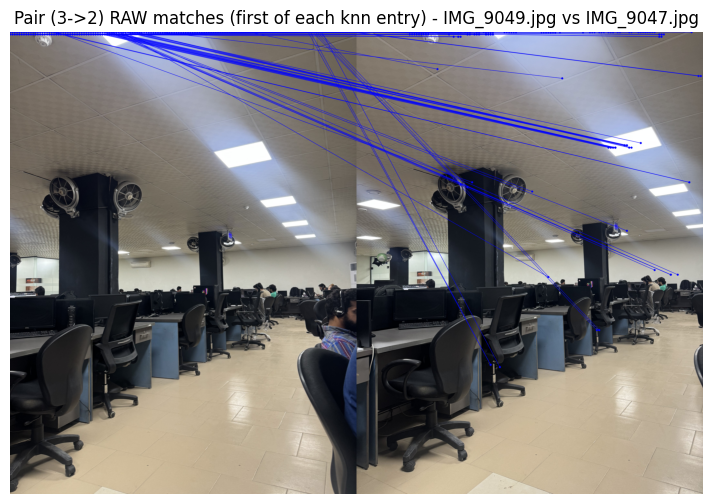

Pair (2,3): raw_simple=30000 good_after_ratio=9126


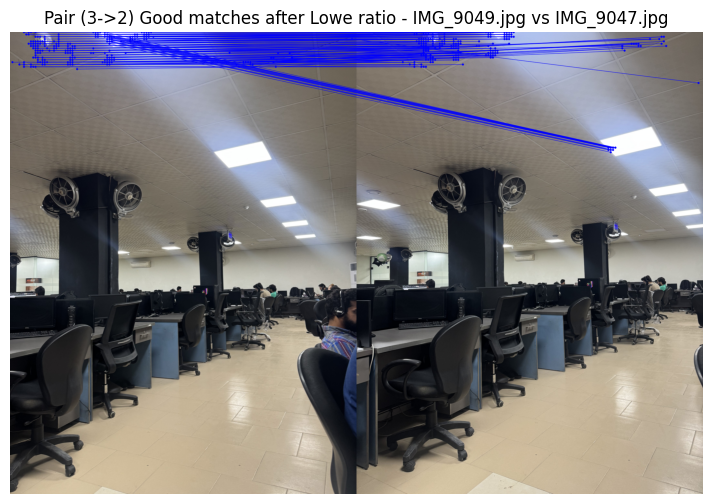

 Pair (2,3) inliers: 5537


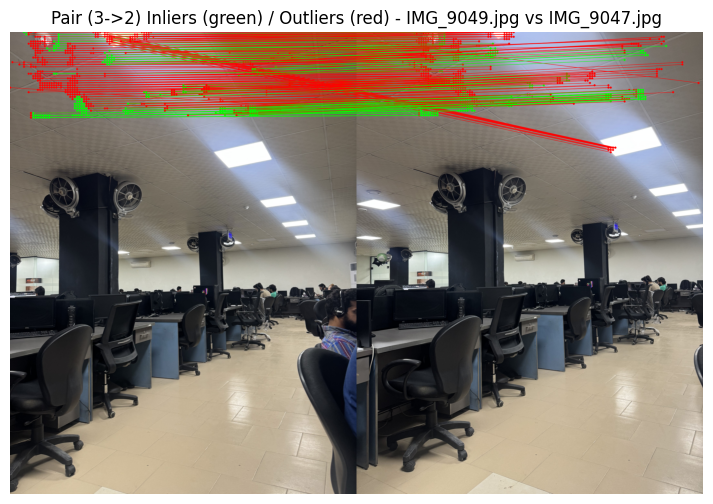

 Stored homography for pair (2,3) with 5537 inliers


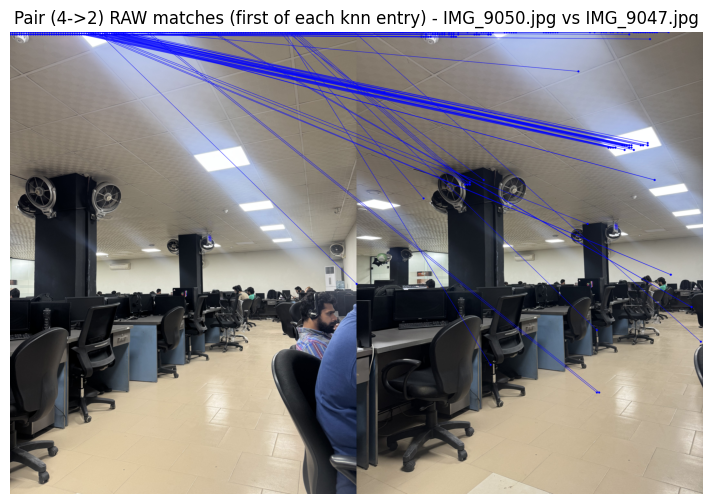

Pair (2,4): raw_simple=30000 good_after_ratio=7333


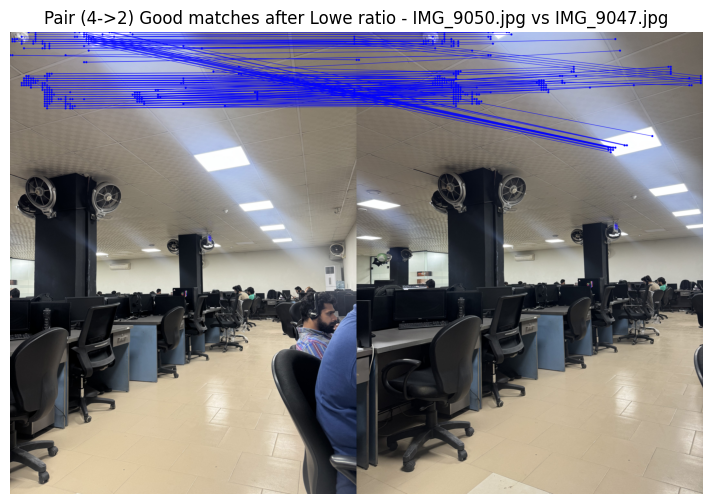

 Pair (2,4) inliers: 3667


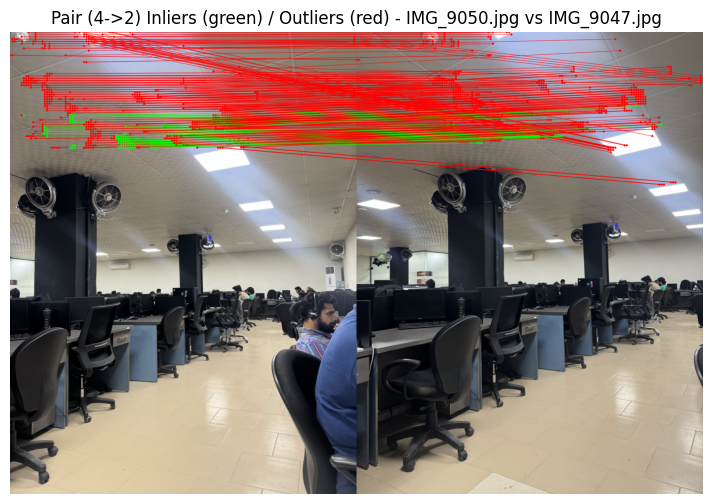

 Stored homography for pair (2,4) with 3667 inliers


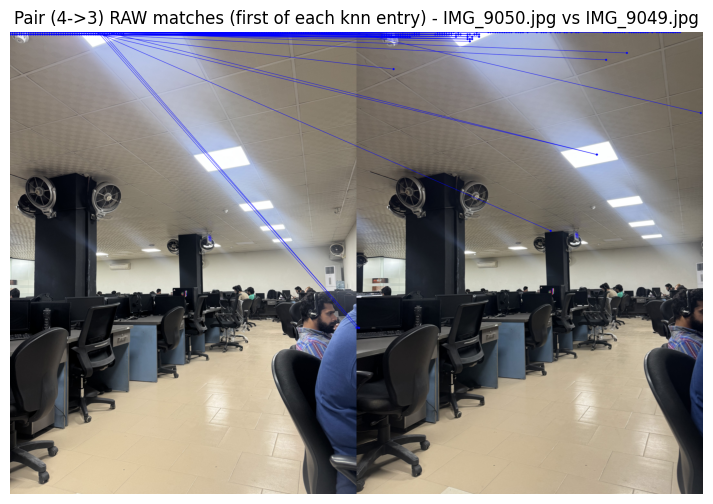

Pair (3,4): raw_simple=30000 good_after_ratio=10831


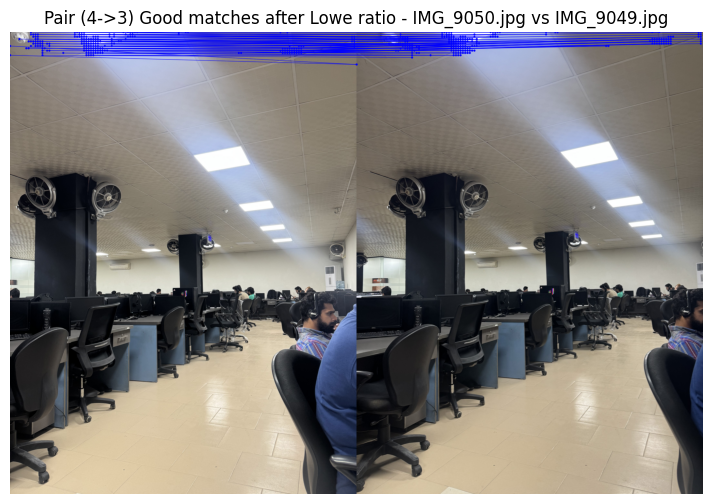

 Pair (3,4) inliers: 6962


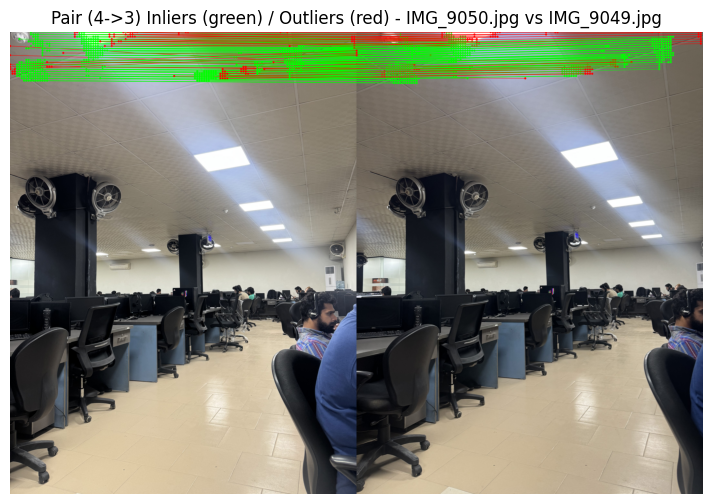

 Stored homography for pair (3,4) with 6962 inliers


In [5]:
import numpy as np

bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=False)
LOWE_RATIO = 0.75
RANSAC_THRESH = 4.0
MIN_INLIERS = 30

N = len(images_color)
pairwise_H = {}
pairwise_inliers = {}

for i in range(N):
    for j in range(i+1, N):
        des_i = descriptors_list[i]
        des_j = descriptors_list[j]
        if des_i.shape[0] == 0 or des_j.shape[0] == 0:
            print(f"Skipping pair ({i},{j}) - no descriptors")
            continue

        # knnMatch: matches from image j -> image i (query=des_j, train=des_i)
        knn_matches = bf.knnMatch(des_j, des_i, k=2)
        # visualize raw matches (use the first match of each knn entry)
        raw_simple = [m_n[0] for m_n in knn_matches if len(m_n) > 0]
        if len(raw_simple) > 0:
            vis_raw = draw_matches_side_by_side(images_color[j], images_color[i],
                                                keypoints_list[j], keypoints_list[i],
                                                raw_simple, matches_mask=None, max_draw=200)
            plt.figure(figsize=(14,6))
            plt.imshow(to_rgb(vis_raw))
            plt.axis("off")
            plt.title(f"Pair ({j}->{i}) RAW matches (first of each knn entry) - {image_files[j]} vs {image_files[i]}")
            plt.show()

        # Lowe ratio test to get good matches
        good = []
        for m_n in knn_matches:
            if len(m_n) < 2:
                continue
            m, n = m_n
            if m.distance < LOWE_RATIO * n.distance:
                good.append(m)

        print(f"Pair ({i},{j}): raw_simple={len(raw_simple)} good_after_ratio={len(good)}")
        if len(good) < 8:
            print(f" Not enough good matches for ({i},{j}) -> skipping homography.")
            continue

        # Show good matches
        vis_good = draw_matches_side_by_side(images_color[j], images_color[i],
                                             keypoints_list[j], keypoints_list[i],
                                             good, matches_mask=None, max_draw=200)
        plt.figure(figsize=(14,6))
        plt.imshow(to_rgb(vis_good))
        plt.axis("off")
        plt.title(f"Pair ({j}->{i}) Good matches after Lowe ratio - {image_files[j]} vs {image_files[i]}")
        plt.show()

        # Build point arrays for homography: pts from j (src) -> pts from i (dst)
        pts_j = np.float32([ keypoints_list[j][m.queryIdx].pt for m in good ]).reshape(-1,2)
        pts_i = np.float32([ keypoints_list[i][m.trainIdx].pt for m in good ]).reshape(-1,2)

        H, mask = cv2.findHomography(pts_j, pts_i, cv2.RANSAC, RANSAC_THRESH)
        if H is None or mask is None:
            print(f" Homography failed for pair ({i},{j})")
            continue
        inliers = int(mask.sum())
        print(f" Pair ({i},{j}) inliers: {inliers}")

        # Visualize inliers (green) and outliers (red)
        mask_list = mask.ravel().tolist()
        vis_inliers = draw_matches_side_by_side(images_color[j], images_color[i],
                                                keypoints_list[j], keypoints_list[i],
                                                good, matches_mask=mask_list, max_draw=500)
        plt.figure(figsize=(14,6))
        plt.imshow(to_rgb(vis_inliers))
        plt.axis("off")
        plt.title(f"Pair ({j}->{i}) Inliers (green) / Outliers (red) - {image_files[j]} vs {image_files[i]}")
        plt.show()

        if inliers >= MIN_INLIERS:
            # store mapping j -> i as in your original pipeline
            pairwise_H[(i,j)] = H
            pairwise_inliers[(i,j)] = inliers
            print(f" Stored homography for pair ({i},{j}) with {inliers} inliers")
        else:
            print(f" Not enough inliers ({inliers}) for robust homography -> not stored")


In [6]:
import numpy as np
from collections import defaultdict, deque

adj = defaultdict(list)
for (i,j), H in pairwise_H.items():
    adj[i].append(j)
    adj[j].append(i)

if len(adj) == 0:
    raise RuntimeError("No pairwise homographies found. Check matches or lower MIN_INLIERS.")

center = max(range(N), key=lambda x: len(adj[x]) if x in adj else 0)
print("Adjacency (non-empty):", {k: adj[k] for k in adj})
print("Chosen center image index:", center, image_files[center])

H_to_center = {center: np.eye(3, dtype=np.float64)}
parent = {center: None}
visited = set([center])
q = deque([center])

while q:
    p = q.popleft()
    for nb in adj.get(p, []):
        if nb in visited:
            continue
        # We need H_nb_to_p (map nb -> p). Our storage format is pairwise_H[(i,j)] means j->i
        H_nb_to_p = None
        if (p, nb) in pairwise_H:
            # stored (p,nb) maps nb -> p (because we stored H as j->i where i=p, j=nb)
            H_nb_to_p = pairwise_H[(p, nb)]
        elif (nb, p) in pairwise_H:
            # stored (nb,p) maps p -> nb, so invert it
            H_p_to_nb = pairwise_H[(nb, p)]
            try:
                H_nb_to_p = np.linalg.inv(H_p_to_nb)
            except np.linalg.LinAlgError:
                H_nb_to_p = None
        if H_nb_to_p is None:
            print(f"WARNING: no homography found to connect {nb} -> {p}, skipping")
            continue
        H_p_to_center = H_to_center[p]
        H_nb_to_center = H_p_to_center @ H_nb_to_p
        H_nb_to_center = H_nb_to_center / H_nb_to_center[2,2]
        H_to_center[nb] = H_nb_to_center
        parent[nb] = p
        visited.add(nb)
        q.append(nb)

print("Computed H_to_center for images:", sorted(list(H_to_center.keys())))
print("Parent tree:", parent)


Adjacency (non-empty): {0: [1, 2, 3, 4], 1: [0, 2, 3, 4], 2: [0, 1, 3, 4], 3: [0, 1, 2, 4], 4: [0, 1, 2, 3]}
Chosen center image index: 0 IMG_9045.jpg
Computed H_to_center for images: [0, 1, 2, 3, 4]
Parent tree: {0: None, 1: 0, 2: 0, 3: 0, 4: 0}


Transformed bounds: 0.0 -226.7088623046875 1669.2470703125 1689.0048828125
Panorama size (w,h): 1670 1916 translate: 0 226.7088623046875


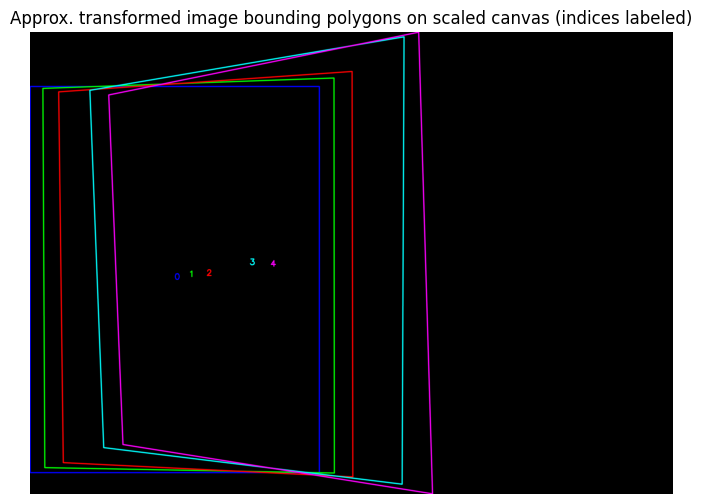

In [7]:
# Cell 7 - Compute canvas bounds and visualize transformed corners
all_corners = []
for idx, img in enumerate(images_color):
    h, w = img.shape[:2]
    corners = np.array([[0,0],[w,0],[w,h],[0,h]], dtype=np.float32).reshape(-1,1,2)
    H = H_to_center.get(idx, np.eye(3))
    trans = cv2.perspectiveTransform(corners, H)
    all_corners.append(trans.reshape(-1,2))

all_corners = np.vstack(all_corners)
xmin, ymin = np.min(all_corners, axis=0)
xmax, ymax = np.max(all_corners, axis=0)
xmin, ymin, xmax, ymax = map(float, (xmin, ymin, xmax, ymax))
print("Transformed bounds:", xmin, ymin, xmax, ymax)

tx = -xmin if xmin < 0 else 0
ty = -ymin if ymin < 0 else 0
out_w = int(np.ceil(xmax + tx))
out_h = int(np.ceil(ymax + ty))
print("Panorama size (w,h):", out_w, out_h, "translate:", tx, ty)

# Visualize transformed corners by plotting canvas-sized blank and drawing corner bounding boxes
canvas = np.zeros((min(out_h, 1200), min(out_w, 1800), 3), dtype=np.uint8)  # downsampled canvas for visualization
scale_x = canvas.shape[1] / out_w if out_w>0 else 1.0
scale_y = canvas.shape[0] / out_h if out_h>0 else 1.0
scale = min(scale_x, scale_y)

plt.figure(figsize=(12,6))
for idx, trans in enumerate(all_corners.reshape(-1,2).reshape(len(images_color)*4,2).reshape(-1,2,)):
    # (we'll instead plot each image box)
    pass

# Instead, draw each transformed image's 4-corner polygon on a scaled canvas
vis = np.zeros((canvas.shape[0], canvas.shape[1], 3), dtype=np.uint8)
colors = [(255,0,0),(0,255,0),(0,0,255),(255,255,0),(255,0,255),(0,255,255)]
for idx, block in enumerate(all_corners.reshape(len(images_color),4,2)):
    pts = block.copy()
    pts[:,0] += tx
    pts[:,1] += ty
    pts_scaled = (pts * scale).astype(np.int32)
    col = colors[idx % len(colors)]
    cv2.polylines(vis, [pts_scaled], isClosed=True, color=col, thickness=2, lineType=cv2.LINE_AA)
    # label
    cx = int(pts_scaled[:,0].mean())
    cy = int(pts_scaled[:,1].mean())
    cv2.putText(vis, str(idx), (cx,cy), cv2.FONT_HERSHEY_SIMPLEX, 0.7, col, 2)

plt.imshow(cv2.cvtColor(vis, cv2.COLOR_BGR2RGB))
plt.title("Approx. transformed image bounding polygons on scaled canvas (indices labeled)")
plt.axis("off")
plt.show()


Warped image 0 nonzero mask pixels: 1920000


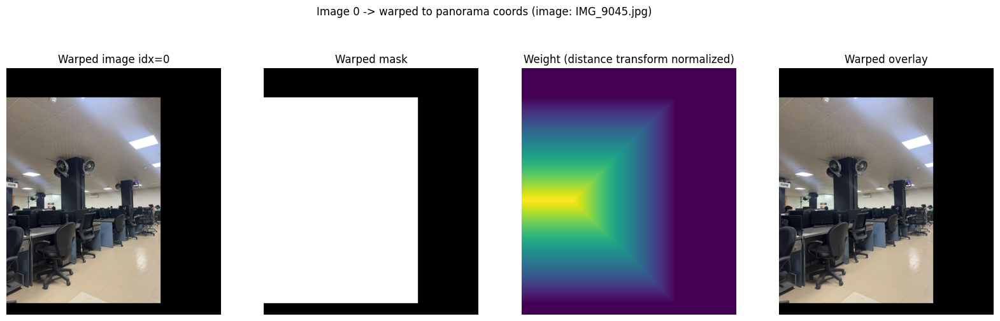

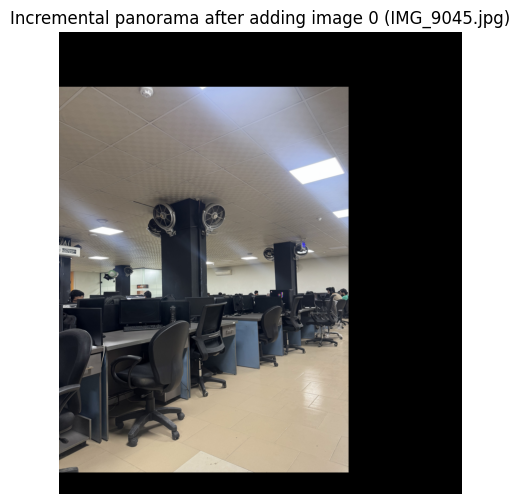

Warped image 1 nonzero mask pixels: 1933322


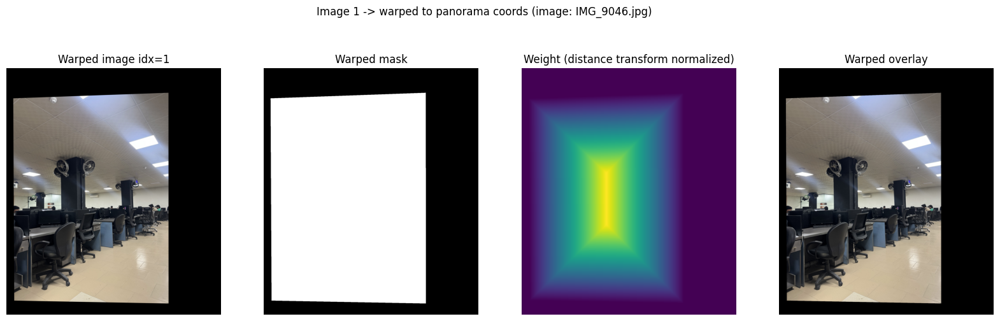

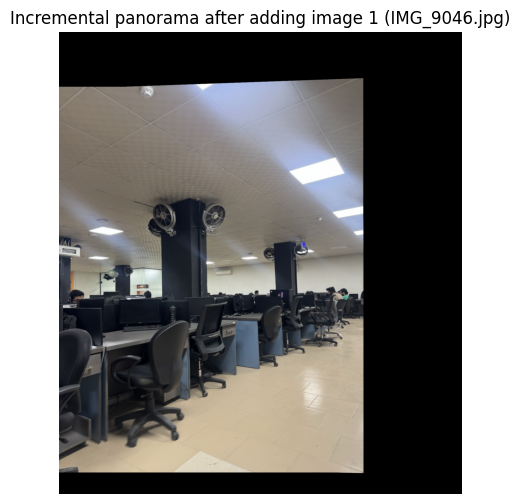

Warped image 2 nonzero mask pixels: 1944801


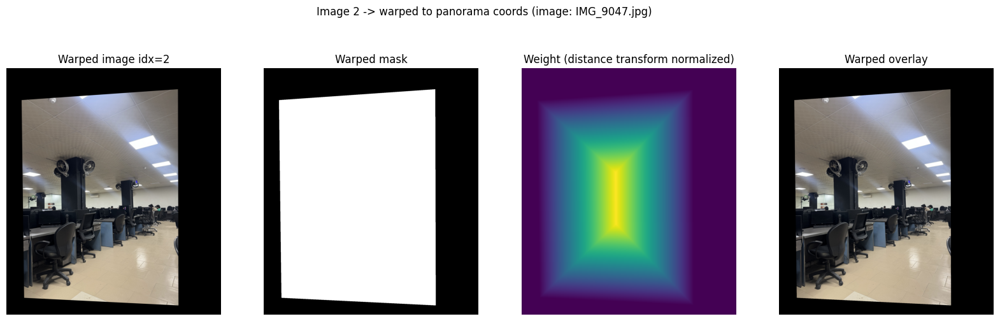

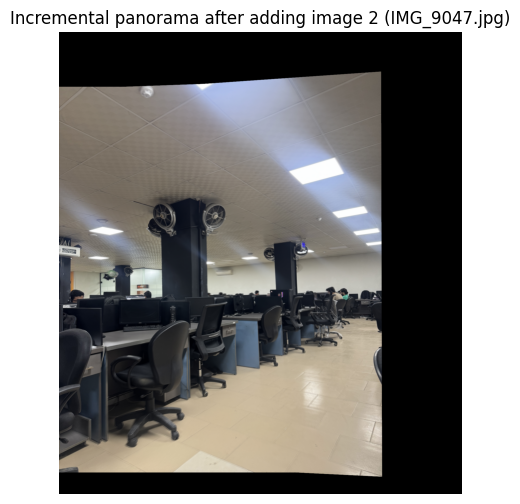

Warped image 3 nonzero mask pixels: 2119196


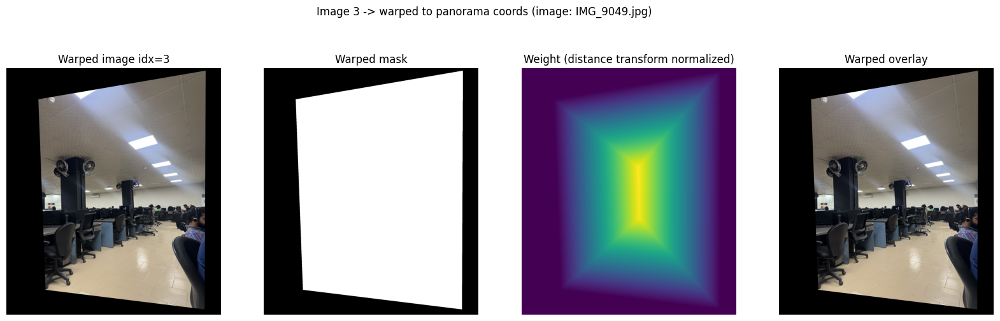

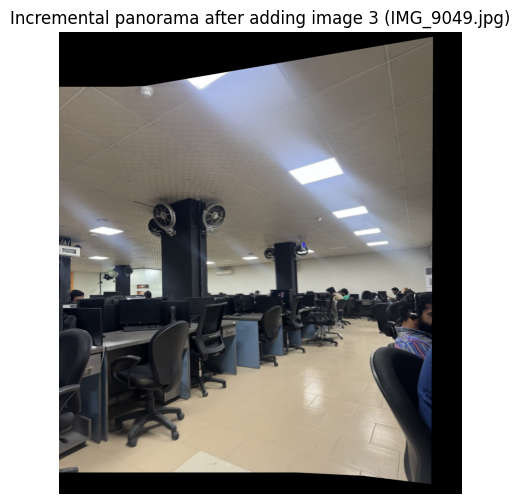

Warped image 4 nonzero mask pixels: 2164213


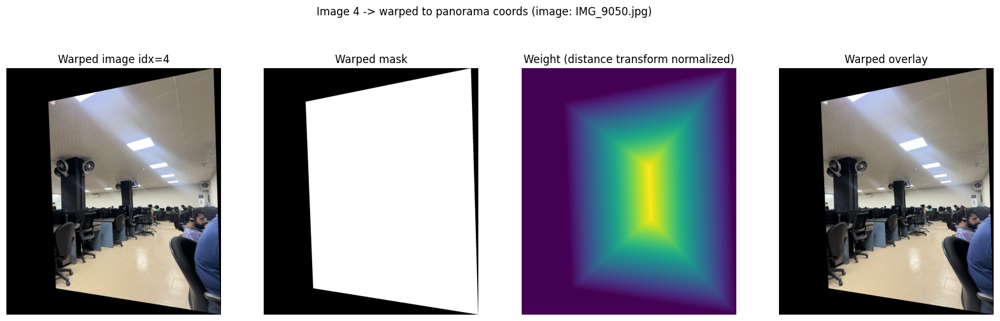

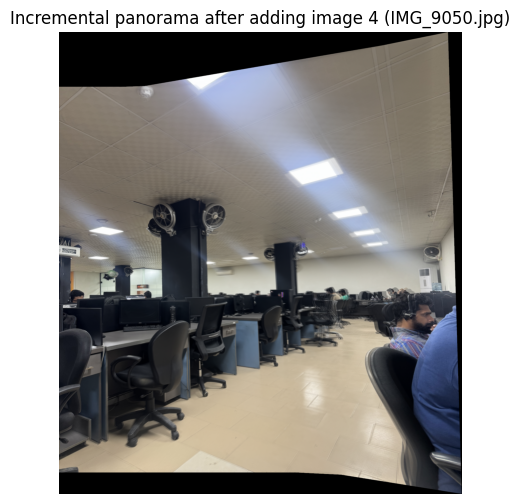

In [8]:
# Cell 8 - Warp, show warped inputs and incremental panorama
accum_img = np.zeros((out_h, out_w, 3), dtype=np.float64)
accum_weight = np.zeros((out_h, out_w), dtype=np.float64)
T = np.array([[1,0,tx],[0,1,ty],[0,0,1]], dtype=np.float64)
eps = 1e-6

for idx, img in enumerate(images_color):
    H = H_to_center.get(idx, np.eye(3))
    H_full = T @ H
    h, w = img.shape[:2]

    # Warp image and mask
    warped = cv2.warpPerspective(img, H_full, (out_w, out_h), flags=cv2.INTER_LINEAR, borderMode=cv2.BORDER_CONSTANT)
    mask = np.zeros((h, w), dtype=np.uint8)
    mask[:] = 255
    warped_mask = cv2.warpPerspective(mask, H_full, (out_w, out_h), flags=cv2.INTER_NEAREST, borderMode=cv2.BORDER_CONSTANT)
    warped_mask_bin = (warped_mask > 0).astype(np.uint8) * 255

    # distance transform based weight
    weight = np.zeros_like(warped_mask_bin, dtype=np.float32)
    if warped_mask_bin.sum() > 0:
        dt = cv2.distanceTransform(warped_mask_bin, distanceType=cv2.DIST_L2, maskSize=5)
        maxv = dt.max() if dt.max() > 0 else 1.0
        weight = dt / maxv
    else:
        weight = weight

    print(f"Warped image {idx} nonzero mask pixels: {np.count_nonzero(warped_mask_bin)}")

    # Show warped image, mask, weight (subplot)
    fig, axs = plt.subplots(1,4, figsize=(20,6))
    axs[0].imshow(to_rgb(warped))
    axs[0].set_title(f"Warped image idx={idx}")
    axs[0].axis("off")

    axs[1].imshow(warped_mask_bin, cmap='gray')
    axs[1].set_title("Warped mask")
    axs[1].axis("off")

    axs[2].imshow(weight, cmap='viridis')
    axs[2].set_title("Weight (distance transform normalized)")
    axs[2].axis("off")

    # For visualization, show warped over a black canvas (overlay)
    overlay = (warped.astype(np.float32) * (warped_mask_bin[...,None]/255.0)).astype(np.uint8)
    axs[3].imshow(to_rgb(overlay))
    axs[3].set_title("Warped overlay")
    axs[3].axis("off")
    plt.suptitle(f"Image {idx} -> warped to panorama coords (image: {image_files[idx]})")
    plt.show()

    # Accumulate
    warped_f = warped.astype(np.float64)
    for c in range(3):
        accum_img[:,:,c] += warped_f[:,:,c] * weight
    accum_weight += weight

    # Show incremental panorama after this addition
    norm = accum_weight[..., None] + eps
    panorama_partial = (accum_img / norm).astype(np.uint8)
    panorama_partial_rgb = cv2.cvtColor(panorama_partial, cv2.COLOR_BGR2RGB)

    plt.figure(figsize=(14,6))
    plt.imshow(panorama_partial_rgb)
    plt.title(f"Incremental panorama after adding image {idx} ({image_files[idx]})")
    plt.axis("off")
    plt.show()


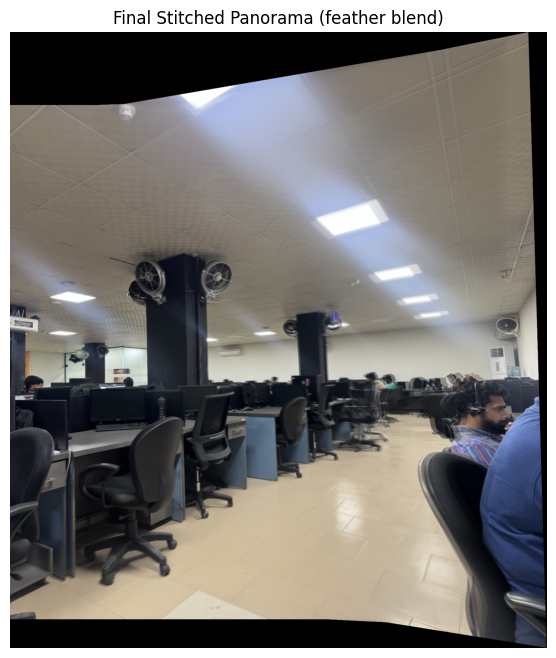

In [9]:
norm = accum_weight[..., None] + 1e-6
panorama = (accum_img / norm).astype(np.uint8)
panorama_rgb = cv2.cvtColor(panorama, cv2.COLOR_BGR2RGB)

plt.figure(figsize=(16,8))
plt.imshow(panorama_rgb)
plt.axis("off")
plt.title("Final Stitched Panorama (feather blend)")
plt.show()


